In [1]:
import csv
import tqdm             
import numpy as np

In [16]:
with open(r'Jan2024.csv', newline='') as f:
    reader = csv.reader(f)
    headers = next(reader)  # Get the header row
    DEP_TIME_index = headers.index('DEP_TIME')
    WHEELS_OFF_index = headers.index('WHEELS_OFF')
    TAXI_OUT_index = headers.index('TAXI_OUT')
    DISTANCE_index = headers.index('DISTANCE')
    AIR_TIME_index = headers.index('AIR_TIME')




    n = int(5e5)
    DEP_TIME_array = np.zeros(n, dtype=float)
    WHEELS_OFF_array = np.zeros(n, dtype=float)
    TAXI_OUT_array = np.zeros(n, dtype=float)
    DISTANCE_array = np.zeros(n, dtype=float)
    AIR_TIME_array = np.zeros(n, dtype=float)



    for count in tqdm.tqdm(range(n)):
        row = next(reader)
        if (row[DEP_TIME_index]!='') and (row[WHEELS_OFF_index]!='') and (row[TAXI_OUT_index]!='') and (row[DISTANCE_index]!='') and (row[AIR_TIME_index]!=''):
            if row[DEP_TIME_index]!='':
                DEP_TIME_array[count] = row[DEP_TIME_index]
            if row[WHEELS_OFF_index]!='':
                WHEELS_OFF_array[count] = row[WHEELS_OFF_index]
            if row[TAXI_OUT_index]!='':
                TAXI_OUT_array[count] = row[TAXI_OUT_index]
            if row[DISTANCE_index]!='':
                DISTANCE_array[count] = row[DISTANCE_index]
            if row[AIR_TIME_index]!='':
                AIR_TIME_array[count] = row[AIR_TIME_index]

        

100%|██████████| 500000/500000 [00:03<00:00, 150669.66it/s]


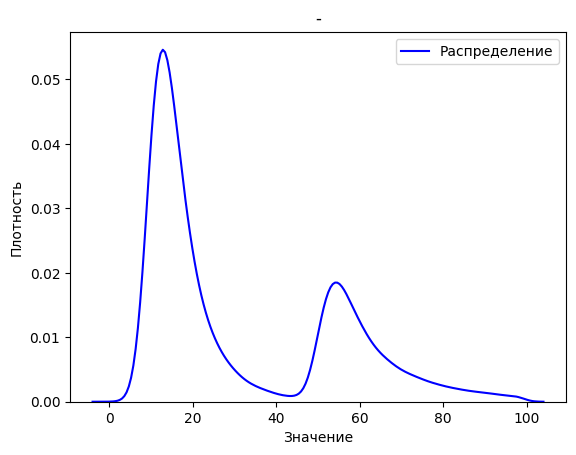

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

array = np.abs(DEP_TIME_array - WHEELS_OFF_array)
arr = [x for x in array if x != 0 and x < 100]



#sns.kdeplot(baseFare_array, label='Распределение', color='blue')
sns.kdeplot(arr, label='Распределение', color='blue')



plt.title('-')
plt.xlabel('Значение')
plt.ylabel('Плотность')


plt.legend()
plt.show()

In [25]:
def graph(data_accuracy, name = '', flag = True):
    if flag:
        layout_accuracy = go.Layout()
        fig1 = go.Figure(data=data_accuracy, layout=layout_accuracy)
        fig1.update_layout(yaxis_title="y", xaxis_title="x", title=name)
        fig1.show()

In [26]:
import plotly.graph_objects as go
Htrace1 = go.Histogram(x=arr,histnorm='probability density', name='Выборка')

graph([Htrace1])

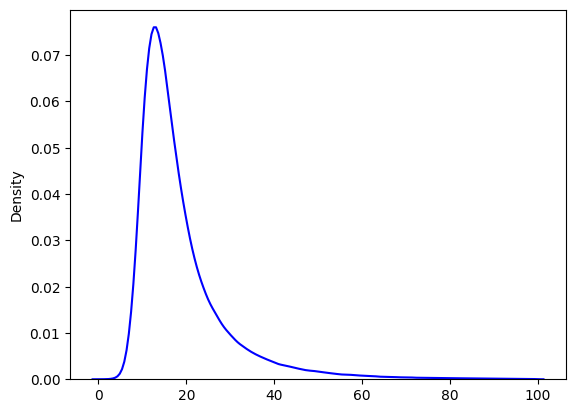

In [14]:
array = np.abs(TAXI_OUT_array)
arr = [x for x in array if x != 0 and x < 100]
sns.kdeplot(arr, label='Распределение', color='blue')
plt.show()

In [15]:
Htrace1 = go.Histogram(x=arr,histnorm='probability density', name='Выборка')
graph([Htrace1])

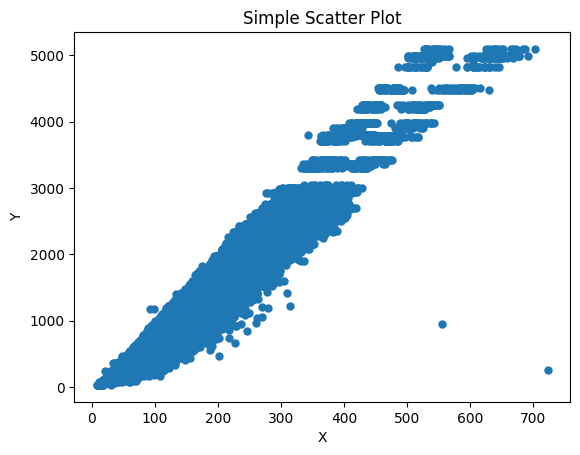

In [20]:
import matplotlib.pyplot as plt

# Create a figure and axis
fig, ax = plt.subplots()
AIR_TIME_array_new = np.array([x for x in AIR_TIME_array if x != 0])
DISTANCE_array_new = np.array([x for x in DISTANCE_array if x != 0])
# Plot the scatter plot
ax.scatter(AIR_TIME_array_new, DISTANCE_array_new,linewidths = 0.01)

# Add labels and title
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Simple Scatter Plot')

# Show the plot
plt.show()

In [27]:
avg_velocity = DISTANCE_array_new/AIR_TIME_array_new
Htrace1 = go.Histogram(x=avg_velocity,histnorm='probability density', name='Выборка')

graph([Htrace1])

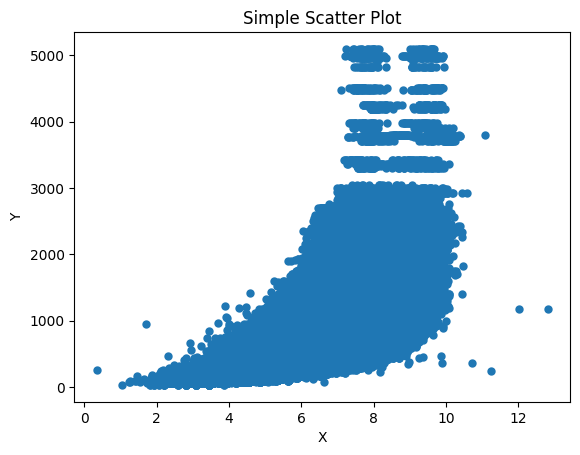

In [30]:
fig, ax = plt.subplots()
ax.scatter(avg_velocity, DISTANCE_array_new,linewidths = 0.01)

# Add labels and title
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Simple Scatter Plot')

# Show the plot
plt.show()